# <font color='red'><ins> Tree ensembles: Random Forest and Boosting </ins></font>

In [1]:
%load_ext autoreload
%autoreload 2

In [91]:
import math
import time
import pickle
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

# Sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
from sklearn.model_selection import cross_val_score

# Smote libraries
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Own libraries
import sys
sys.path.append('../src')
from preprocessing import *
from plotting import *
from utils import *

# 1. Random Forest

## 1.1. Hyperparameter tuning

To tune the hyperparameters of our models we are going to use the preprocessed dataset, i.e., the dataset where the stimulus start/end points are corrected.

Once, we have the best hyperparameters for a model, we are going to train-test again using only those hyperparameters but with a larger amount of repetitions to get a better generalization error estimation.

In [113]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

In [114]:
df_db_prep = group_datafiles_byID('../datasets/preprocessed/HT_Sensor_prep_metadata.dat', 
                                  '../datasets/preprocessed/HT_Sensor_prep_dataset.dat')
df_db_prep = reclassify_series_samples(df_db_prep)

In [5]:
n_estimators = [100, 300, 500]
criterions = ['gini', 'entropy']
max_depths = [3, 7, 11]

In [7]:
VAL_REPS = 10

for nest in n_estimators:
    for crit in criterions:
        for depth in max_depths:
            # Mean error arrays
            errs_acc = []
            errs_f1 = []
            for i in range(VAL_REPS):
                # Splitting set in train (80%) and test set
                df_train, df_test = split_series_byID(0.8, df_db_prep)
                xtrain, ytrain = df_train[features].values, df_train['class'].values
                xtest, ytest = df_test[features].values, df_test['class'].values

                # Init clf
                rfc = RandomForestClassifier(n_estimators=nest, criterion=crit, max_depth=depth, n_jobs=-1)
                # Train clf on train set
                rfc.fit(xtrain, ytrain)
                # Getting clf metrics on test set
                y_pred = rfc.predict(xtest)
                acc = accuracy_score(ytest, y_pred)
                f1 = f1_score(ytest, y_pred, average='weighted')
                errs_acc.append(acc)
                errs_f1.append(f1)

            errs_acc = np.asarray(errs_acc)
            errs_f1 = np.asarray(errs_f1)
            print('============================================')
            print('N estimators:', nest)
            print('Criterion:', crit)
            print('Max depth:', depth)
            print('Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
            print('Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())
            print('============================================')



N estimators: 100
Criterion: gini
Max depth: 3
Mean accuracy: 0.7946293751841381 +- 0.022340149438788016
Mean F1-Score: 0.7314064184956269 +- 0.030436776219018077
N estimators: 100
Criterion: gini
Max depth: 7
Mean accuracy: 0.8251705066757214 +- 0.030385405371009255
Mean F1-Score: 0.7917698460100201 +- 0.018411437142537727
N estimators: 100
Criterion: gini
Max depth: 11
Mean accuracy: 0.776987711616818 +- 0.014463698691850284
Mean F1-Score: 0.7329256062850488 +- 0.020797267302252044
N estimators: 100
Criterion: entropy
Max depth: 3
Mean accuracy: 0.8466922047650249 +- 0.02000570277513751
Mean F1-Score: 0.7974078702927899 +- 0.029569765180974403
N estimators: 100
Criterion: entropy
Max depth: 7
Mean accuracy: 0.8627773045945877 +- 0.02029268053720007
Mean F1-Score: 0.8392944292939127 +- 0.030397185278727448
N estimators: 100
Criterion: entropy
Max depth: 11
Mean accuracy: 0.835719748657015 +- 0.02583066191467667
Mean F1-Score: 0.7962037954114768 +- 0.035905305820405374
N estimators: 30

## 1.2 Performance in preprocessed dataset with best hyperparameters

In [121]:
REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db_prep)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Init clf
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    # Train clf on train set
    rfc.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8414028882140423 +- 0.05468688180260027
==> Mean F1-Score: 0.803443096356573 +- 0.06662512033726693


## 1.3 Performance in moving window dataset with best hyperparameters

In [95]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win = pickle.load(f)

In [97]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db_win)
    df_train, df_test = norm_train_test(df_train, df_test, features)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Init clf
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    # Train clf on train set
    rfc.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8781987583977502 +- 0.04019397935218523
==> Mean F1-Score: 0.8508385828524208 +- 0.04978932406137678


## 1.4 Performance normalizing and using SMOTE

In the next cell we are going to execute **several Random Forest classifiers**.

The datasets used for training are:
- *Raw dataset*: initial dataset of the original authors article/repository.
- *Preprocessed dataset*: higher quality dataset, where certain values have been corrected (stimulus start/end points).
- *Moving windows dataset*: dataset where several features have been added to capture the last 120 samples mean and std (moving average + moving std).

For all these datasets, **normalization has been tested**, as weel as the **Synthetic Minority Oversample Technique (SMOTE) for imbalanced data**.

In [9]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

########################################################################################
#   RAW DATASET
#       Normalized and not normalized: using SMOTE in both cases
#########################################################################################
df_db_raw = group_datafiles_byID('../datasets/raw/HT_Sensor_metadata.dat', 
                             '../datasets/raw/HT_Sensor_dataset.dat')
df_db_raw = reclassify_series_samples(df_db_raw)

errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

# Oversampling and undersampling dictionary
over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING WITHOUT NORMALIZING
for i in range(10):
    # Reading dataset and splitting
    df_train_raw, df_test_raw = split_series_byID(0.8, df_db_raw)
    xtrain, ytrain = df_train_raw[features].values, df_train_raw['class'].values
    xtest, ytest = df_test_raw[features].values, df_test_raw['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=6, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=6, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Raw not norm ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())



errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING NORMALIZING
for i in range(10):
    # Reading dataset, splitting and normalizing
    df_train_raw, df_test_raw = split_series_byID(0.8, df_db_raw)
    df_train_raw, df_test_raw = norm_train_test(df_train_raw, df_test_raw, features)
    xtrain, ytrain = df_train_raw[features].values, df_train_raw['class'].values
    xtest, ytest = df_test_raw[features].values, df_test_raw['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=6, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=6, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Raw normalized ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())



########################################################################################
#   PREPROCESSED DATASET
#       Normalized and not normalized: using SMOTE in both cases
#########################################################################################
df_db_prep = group_datafiles_byID('../datasets/preprocessed/HT_Sensor_prep_metadata.dat', 
                             '../datasets/preprocessed/HT_Sensor_prep_dataset.dat')
df_db_prep = reclassify_series_samples(df_db_prep)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING WITHOUT NORMALIZING
for i in range(10):
    # Reading dataset and splitting
    df_train_prep, df_test_prep = split_series_byID(0.8, df_db_prep)
    xtrain, ytrain = df_train_prep[features].values, df_train_prep['class'].values
    xtest, ytest = df_test_prep[features].values, df_test_prep['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Prep not norm ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())



errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING NORMALIZING
for i in range(10):
    # Reading dataset, splitting and normalizing
    df_train_prep, df_test_prep = split_series_byID(0.8, df_db_prep)
    df_train_prep, df_test_prep = norm_train_test(df_train_prep, df_test_prep, features)
    xtrain, ytrain = df_train_prep[features].values, df_train_prep['class'].values
    xtest, ytest = df_test_prep[features].values, df_test_prep['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Prep normalized ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())



########################################################################################
#   PREPROCESSED DATASET with MOVING WINDOWS
#       Normalized and not normalized: using SMOTE in both cases
#########################################################################################
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db = pickle.load(f)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING WITHOUT NORMALIZING
for i in range(10):
    # Reading dataset and splitting
    df_train, df_test = split_series_byID(0.8, df_db)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Windows 120 not norm ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())


features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']
errs_acc = []
errs_f1 = []
errs_acc_smote = []
errs_f1_smote = []

over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

# TRAINING NORMALIZING
for i in range(10):
    # Reading dataset, splitting and normalizing
    df_train, df_test = split_series_byID(0.8, df_db)
    df_train, df_test = norm_train_test(df_train, df_test, features)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Training without using SMOTE
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

    # Training using SMOTE
    oversample = SMOTE(sampling_strategy=over_dict)
    undersample = RandomUnderSampler(sampling_strategy=under_dict)
    xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
    xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   
    rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
    rfc.fit(xtrain, ytrain)
    y_pred = rfc.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc_smote.append(acc)
    errs_f1_smote.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
errs_acc_smote = np.asarray(errs_acc_smote)
errs_f1_smote = np.asarray(errs_f1_smote)
print('==== Windows 120 normalized ====')
print('Accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('f1-score:', errs_f1.mean(), '+-', errs_f1.std())
print('Accuracy (smote):', errs_acc_smote.mean(), '+-', errs_acc_smote.std())
print('f1-score (smote):', errs_f1_smote.mean(), '+-', errs_f1_smote.std())

==== Raw not norm ====
Accuracy: 0.8418960522995799 +- 0.03632088039392034
f1-score: 0.7971172515127904 +- 0.04712454772292015
Accuracy (smote): 0.8277699338947454 +- 0.03764657496658198
f1-score (smote): 0.8082176890316616 +- 0.041986899096288714
==== Raw normalized ====
Accuracy: 0.8435238958626406 +- 0.016988139870408495
f1-score: 0.8044838931123677 +- 0.02726273359176542
Accuracy (smote): 0.8352368865135366 +- 0.029350892504258912
f1-score (smote): 0.8167438646556081 +- 0.03198988701165813
==== Prep not norm ====
Accuracy: 0.8065367076851159 +- 0.029776930251357886
f1-score: 0.7572592024620618 +- 0.03996370131297966
Accuracy (smote): 0.7907933461773212 +- 0.029474943405134558
f1-score (smote): 0.7667767335193576 +- 0.03574504446815725
==== Prep normalized ====
Accuracy: 0.8518799497840609 +- 0.046531772282859415
f1-score: 0.8152035473309679 +- 0.06113266960072451
Accuracy (smote): 0.8308586053612501 +- 0.05510826568942438
f1-score (smote): 0.816378820351669 +- 0.057696944279277226


## 1.5 Analyzing misclassified examples

Let's start **nalyzing a random Random Forest trained in moving window dataset**, with which we obtained the best performance, but **without using SMOTE**. We normalize the dataset because of the fact that moving-window dataset has several attributes with different scale, not like preprocessed (instantaneous) dataset.

Once we have the classifier trained, we are going to plot **several graphics**, trying to come up with new ideas to improve the performance on imbalanced classes.

In [57]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win_noSmote = pickle.load(f)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

In [62]:
# Reading dataset, splitting and normalizing
df_train, df_test = split_series_byID(0.8, df_db_win_noSmote)
df_train, df_test = norm_train_test(df_train, df_test, features)
xtrain, ytrain = df_train[features].values, df_train['class'].values
xtest, ytest = df_test[features].values, df_test['class'].values

In [63]:
# Init and training
rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
rfc.fit(xtrain, ytrain)
# Predicting
y_pred = rfc.predict(xtest)
# Metrics
acc = accuracy_score(ytest, y_pred)
f1 = f1_score(ytest, y_pred, average='weighted')
print('Accuracy', acc)
print('F1-Score:', f1)

Accuracy 0.880294475694736
F1-Score: 0.8513557644690667


TEST SET PROPORTIONS:
	Real background percentage: 0.7256475107043909
	Real banana percentage: 0.07894488288137017
	Real wine percentage: 0.19540760641423893
------------------------------------------
Accuracy: 0.880294475694736
Recall on background: 0.9794346703690044
Recall on banana: 0.06467264872050515
Recall on wine: 0.8416487647690655
F1-score: 0.8513557644690667


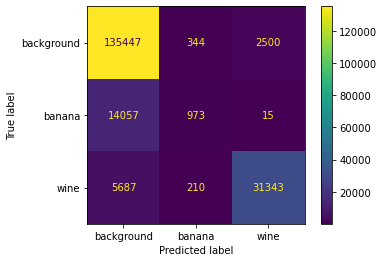

In [64]:
metric_report(ytest, y_pred, plot_conf_mtx=True, clf=rfc, X=xtest)

In [65]:
set(df_test['id'])

{4, 5, 13, 14, 18, 24, 25, 29, 38, 41, 47, 55, 62, 67, 68, 78, 90, 91, 96, 97}

In [66]:
probs_mtx = rfc.predict_proba(xtest)

First, we are going to see that banana stimulus is **hard to detect**, due to the gases produced by a banana are hard to identify for those "common" sensors. Almost all samples of banana have been misclassified: we can check it either in 'recall on banana' using the previous confusion matrix or either the misclassified data graphic.

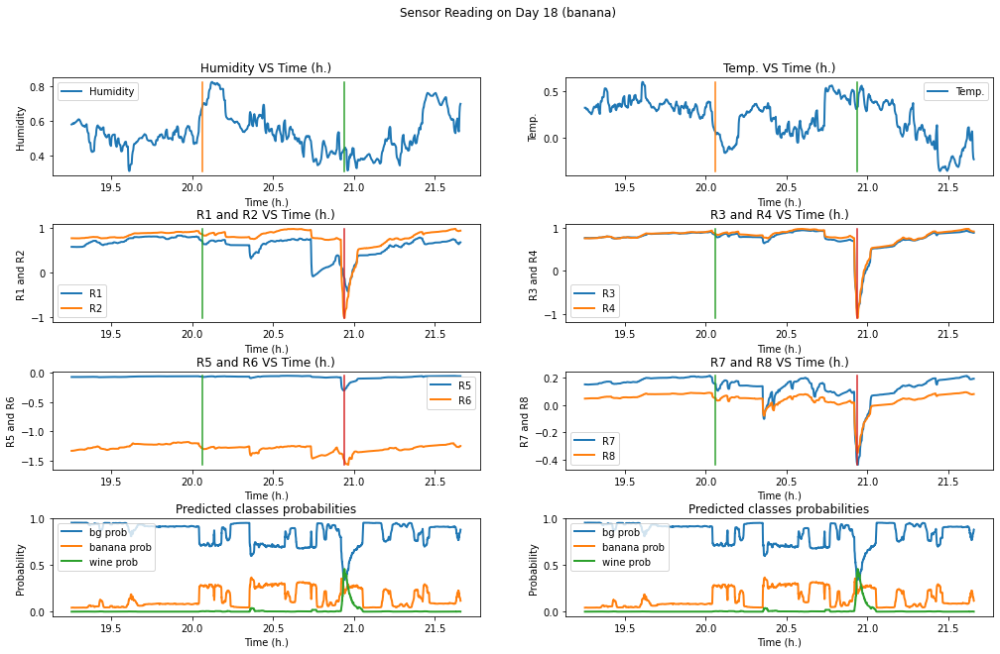

In [77]:
plot_probs_byID(df_test, 18, probs_mtx)

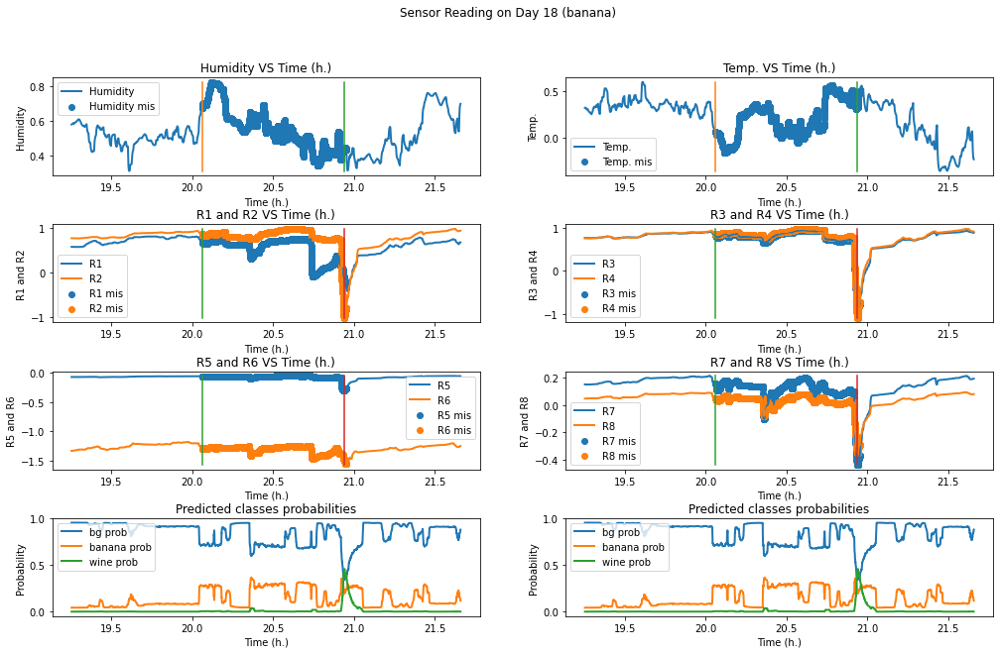

In [70]:
plot_misclassified_byID(df_test, 18, ytest, y_pred, probs_mtx=probs_mtx)

We perform better at wine stimulus, but we can still improve the results. As we can see below, some samples are misclassfied in the middle of the stimulus. However, this serie is considered to be a *hard* wine serie, were seem to be a lot of noise in the sensor readings.

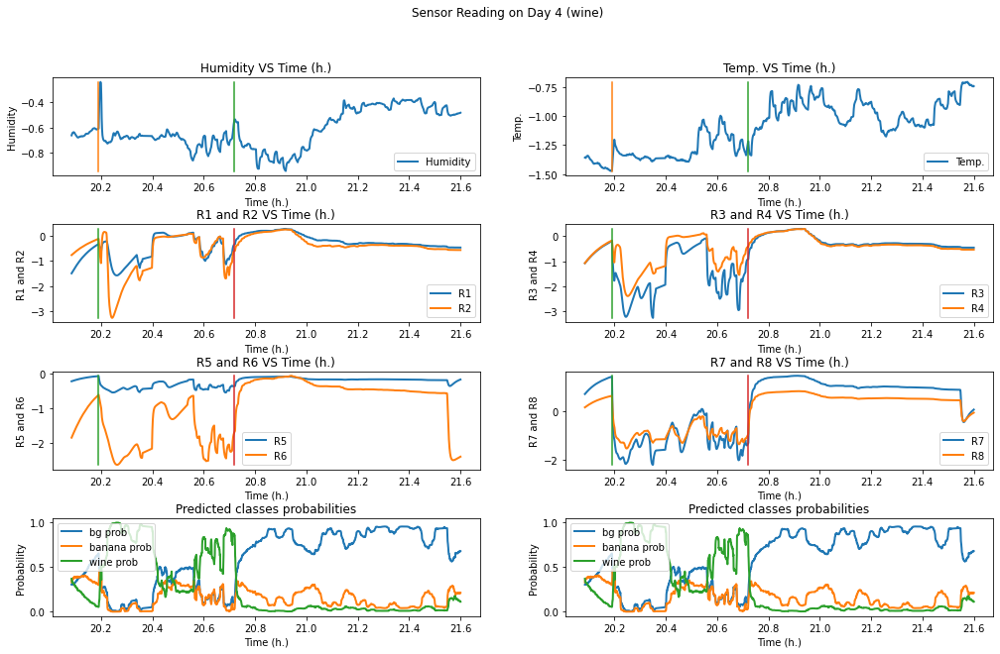

In [78]:
plot_probs_byID(df_test, 4, probs_mtx)

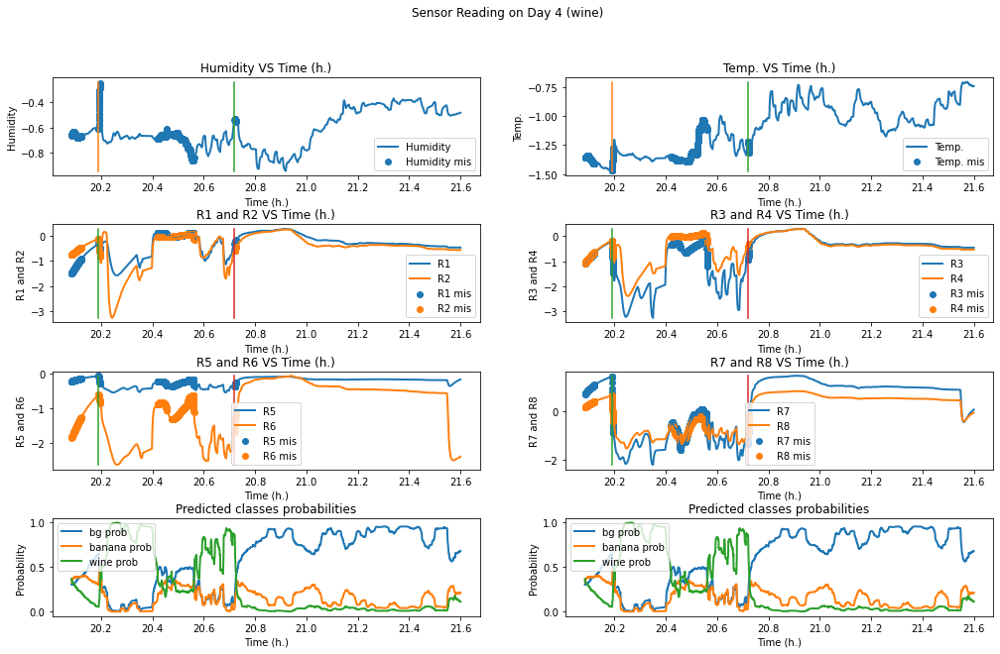

In [76]:
plot_misclassified_byID(df_test, 4, ytest, y_pred, probs_mtx=probs_mtx)

Finally, we can easily check that background samples are correctly classified.

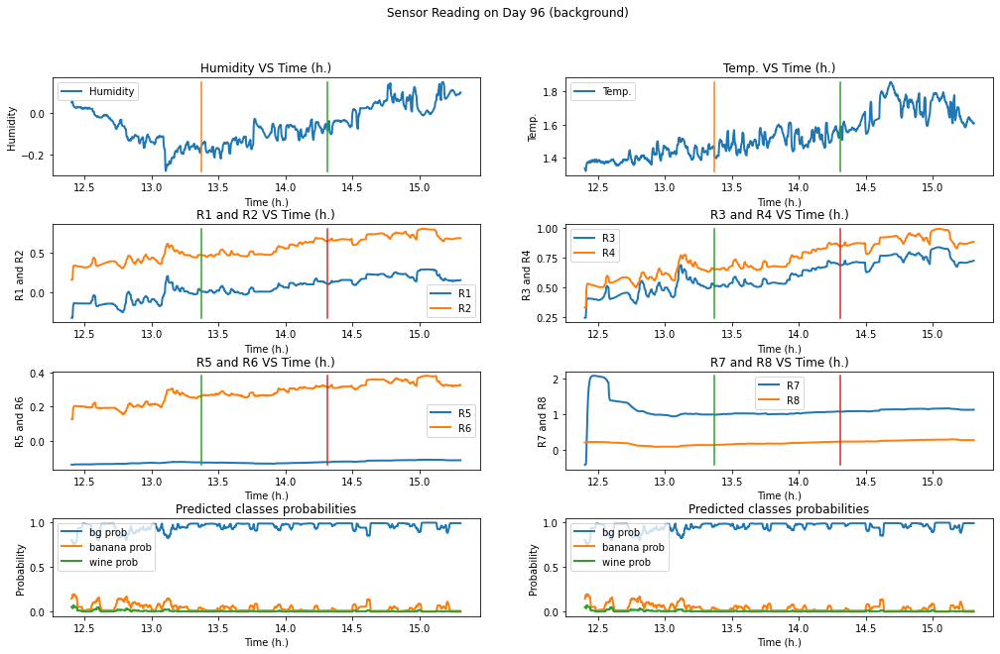

In [79]:
plot_probs_byID(df_test, 96, probs_mtx)

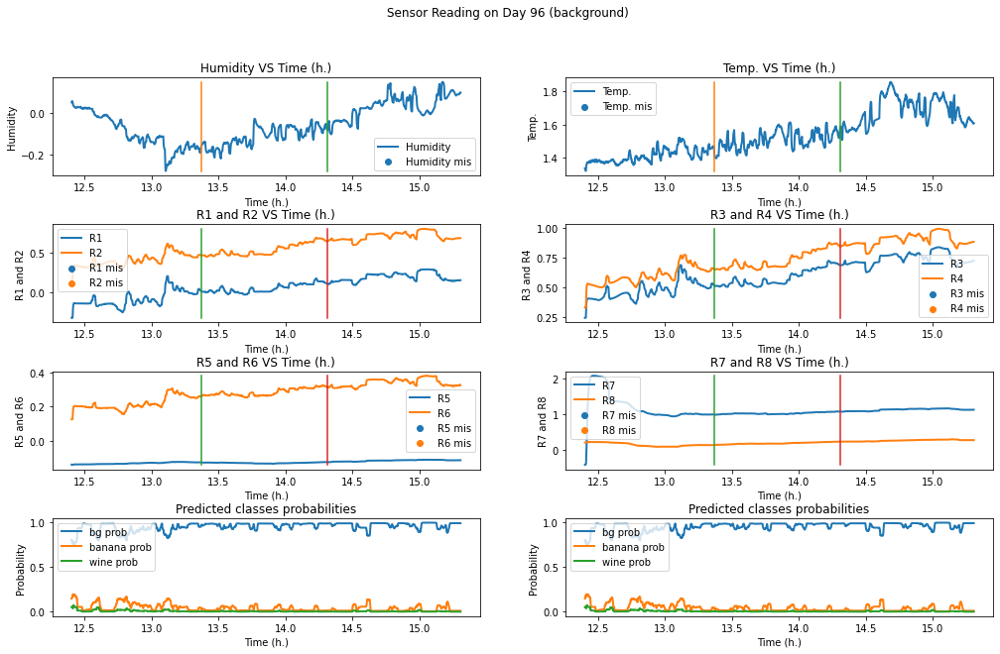

In [72]:
plot_misclassified_byID(df_test, 96, ytest, y_pred, probs_mtx=probs_mtx)

Now, let's train a random forest classifier on moving window normalized dataset using SMOTE. This should improve F1-Score without hurting accuracy performance, forcing the classifier not to focus excessively on background examples, and improving the recall in the rest of the minority classes.

In addiction, we are going to analyze the misclassified examples, trying to observe improvement patterns.

In [19]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win = pickle.load(f)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

In [25]:
# Reading dataset, splitting and normalizing
df_train, df_test = split_series_byID(0.8, df_db_win)
df_train, df_test = norm_train_test(df_train, df_test, features)
xtrain, ytrain = df_train[features].values, df_train['class'].values
xtest, ytest = df_test[features].values, df_test['class'].values

In [26]:
# SMOTE: Oversampling + undersampling
over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}

oversample = SMOTE(sampling_strategy=over_dict)
undersample = RandomUnderSampler(sampling_strategy=under_dict)
xtrain, ytrain = oversample.fit_resample(xtrain, ytrain)
xtrain, ytrain = undersample.fit_resample(xtrain, ytrain)   

In [27]:
# Init and training
rfc = RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=7, n_jobs=-1)
rfc.fit(xtrain, ytrain)
# Predicting
y_pred = rfc.predict(xtest)
# Metrics
acc = accuracy_score(ytest, y_pred)
f1 = f1_score(ytest, y_pred, average='weighted')
print('Accuracy', acc)
print('F1-Score:', f1)

Accuracy 0.9083316147659312
F1-Score: 0.9062767381540939


TEST SET PROPORTIONS:
	Real background percentage: 0.7438750257785111
	Real banana percentage: 0.05091771499278202
	Real wine percentage: 0.20520725922870695
------------------------------------------
Accuracy: 0.9083316147659312
Recall on background: 0.9291734242663673
Recall on banana: 0.31470230862697446
Recall on wine: 0.9800763780714536
F1-score: 0.9062767381540939


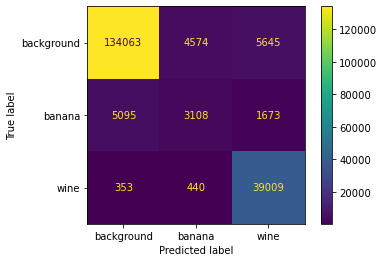

In [30]:
metric_report(ytest, y_pred, plot_conf_mtx=True, clf=rfc, X=xtest)

In [32]:
set(df_test['id'])

{0, 8, 14, 24, 29, 32, 36, 41, 44, 46, 49, 53, 59, 70, 77, 79, 83, 84, 89, 99}

In [33]:
probs_mtx = rfc.predict_proba(xtest)

Even though we **have improved the classified performance on banana examples using SMOTE**, the results are not the most desirable

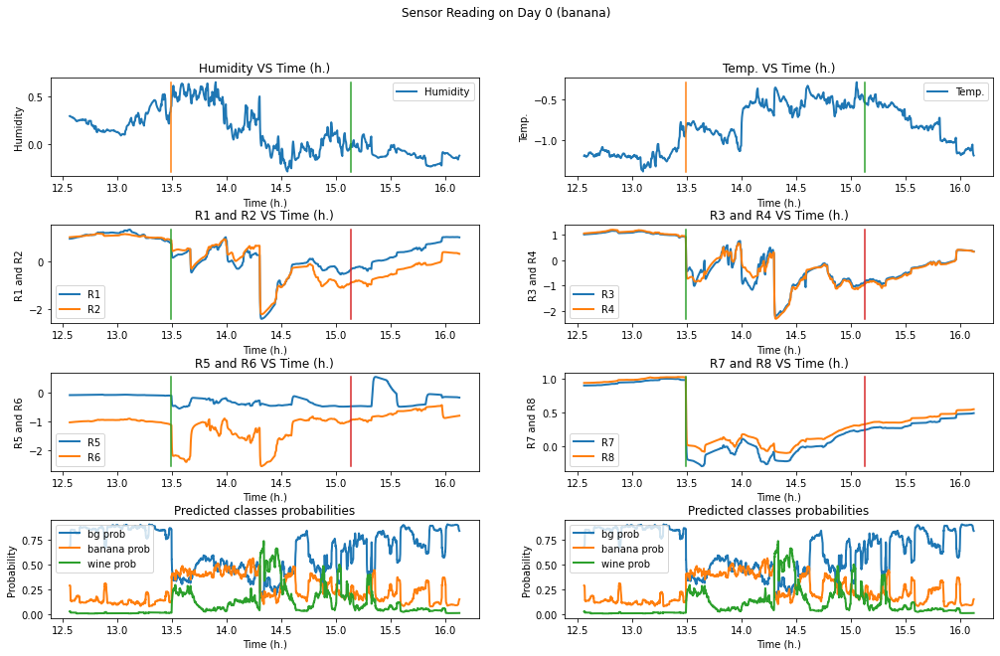

In [34]:
plot_probs_byID(df_test, 0, probs_mtx)

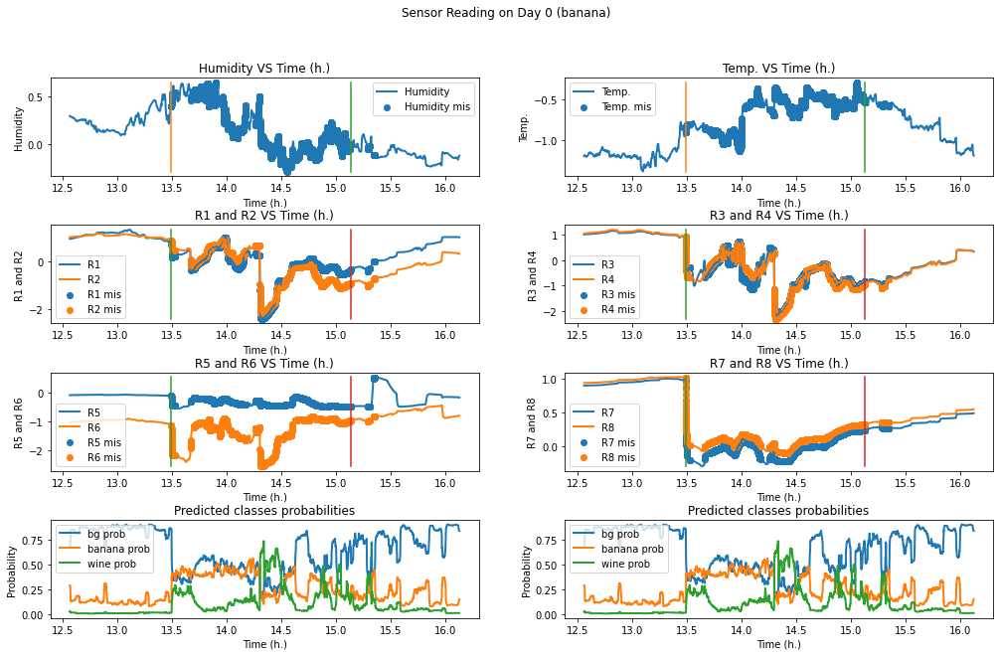

In [47]:
plot_misclassified_byID(df_test, 0, ytest, y_pred, probs_mtx=probs_mtx)

**SMOTE have done a good job improving the classifier performance on wine samples**, as we can see in the next graphics, where almost all wine samples have been classified correctly, except those **near stimulus limit**.

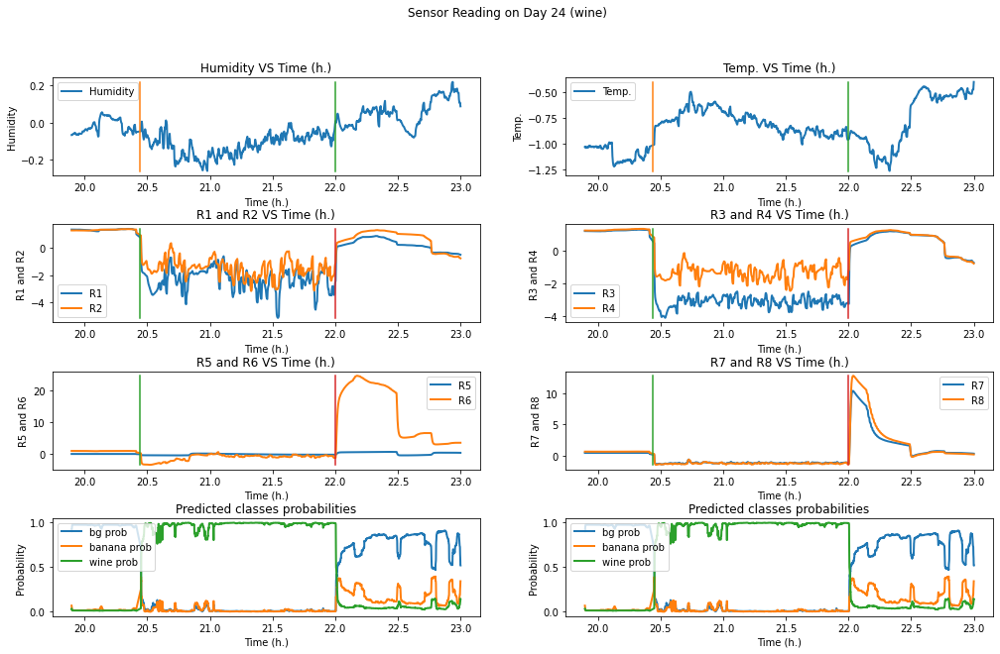

In [54]:
plot_probs_byID(df_test, 24, probs_mtx)

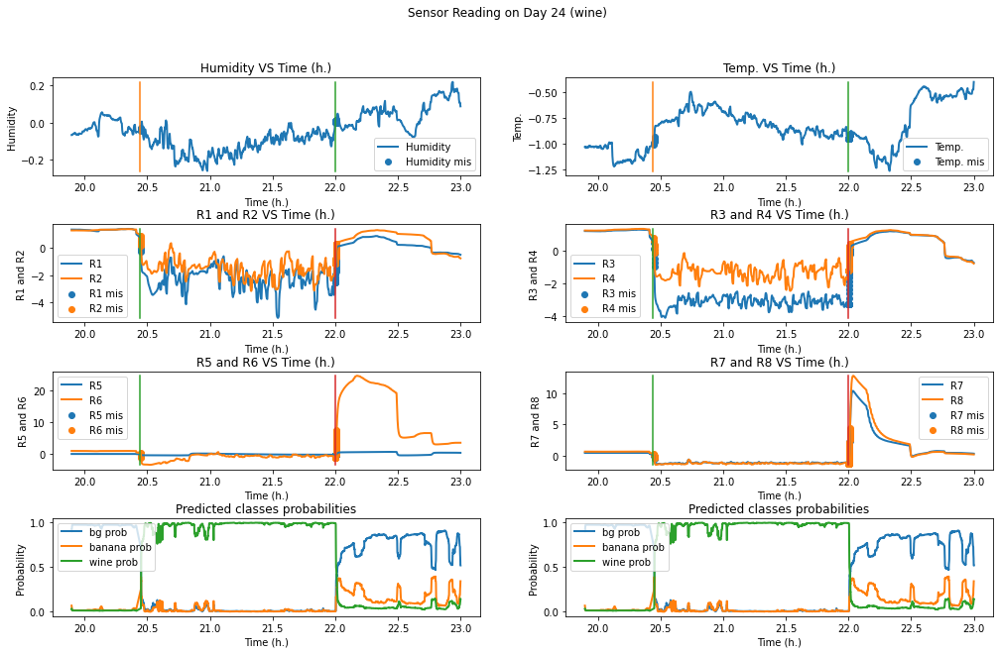

In [53]:
plot_misclassified_byID(df_test, 24, ytest, y_pred, probs_mtx=probs_mtx)

The **baseline samples keep being classified correctly** even though several samples have been removed using **undersampling in SMOTE procedure**. Maybe we would need to try out what would happen if we remove even more background and generate more banana examples.

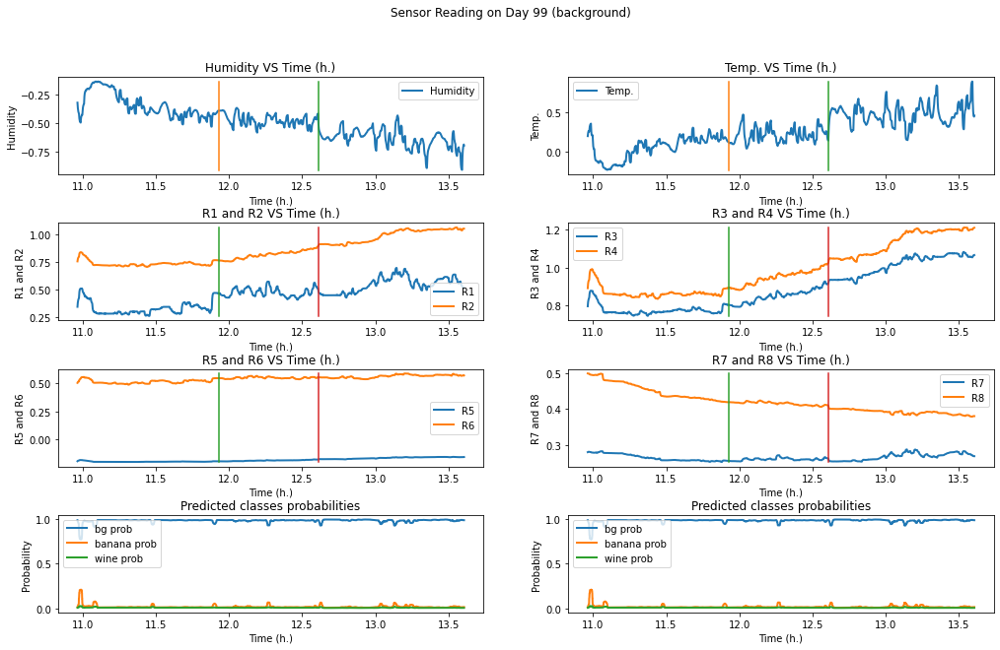

In [55]:
plot_probs_byID(df_test, 99, probs_mtx)

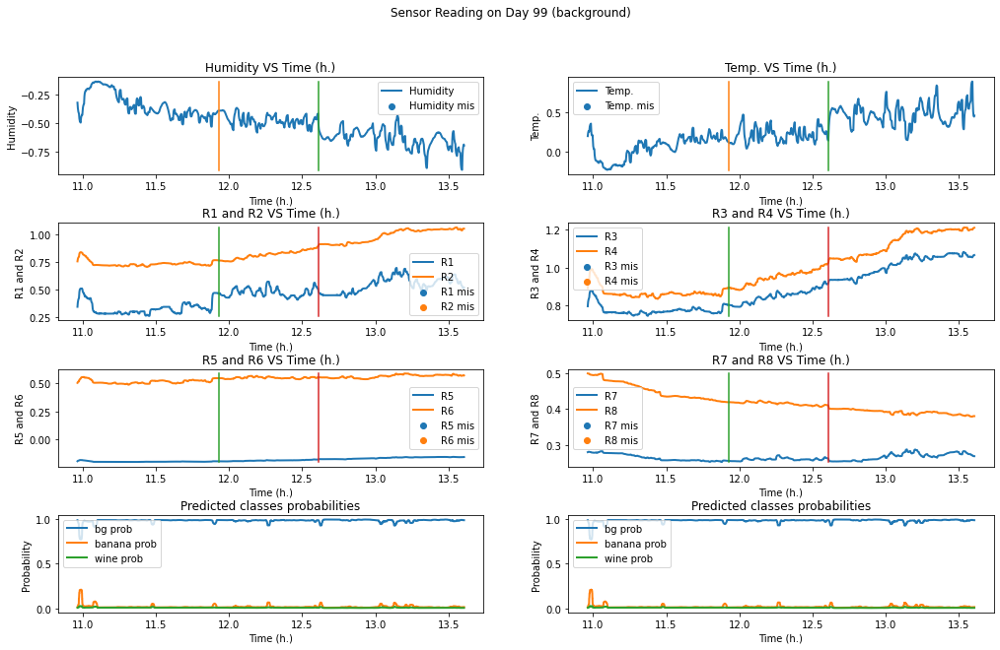

In [56]:
plot_misclassified_byID(df_test, 99, ytest, y_pred, probs_mtx=probs_mtx)

# 2. Boosting

## 2.1 Hyperparameter tuning

In [87]:
df_db = group_datafiles_byID('../datasets/preprocessed/HT_Sensor_prep_metadata.dat',
                             '../datasets/preprocessed/HT_Sensor_prep_dataset.dat')
df_db = reclassify_series_samples(df_db)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

In [92]:
base_estim = DecisionTreeClassifier(criterion='entropy', max_depth=7, max_features='auto')

In [93]:
n_estimators = [100, 300]
learning_rate = [0.1, 0.5, 1]

In [94]:
NREPS = 10

for nest in n_estimators:
    for lr in learning_rate:
        # Mean error arrays
        errs_acc = []
        errs_f1 = []
        for i in range(NREPS):
            # Reading dataset, splitting and normalizing
            df_train, df_test = split_series_byID(0.8, df_db)
            xtrain, ytrain = df_train[features].values, df_train['class'].values
            xtest, ytest = df_test[features].values, df_test['class'].values

            # Init clf
            clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=nest, learning_rate=lr)
            # Train clf on train set
            clf_boost.fit(xtrain, ytrain)
            # Getting clf metrics on test set
            y_pred = clf_boost.predict(xtest)
            acc = accuracy_score(ytest, y_pred)
            f1 = f1_score(ytest, y_pred, average='weighted')
            errs_acc.append(acc)
            errs_f1.append(f1)
        
        errs_acc = np.asarray(errs_acc)
        errs_f1 = np.asarray(errs_f1)
        print('============================================')
        print('N estimators:', nest)
        print('Learning rate:', lr)
        print('Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
        print('Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())
        print('============================================')


N estimators: 100
Learning rate: 0.1
Mean accuracy: 0.7659854296421317 +- 0.05163400211046207
Mean F1-Score: 0.7181977371580527 +- 0.057219021252517814
N estimators: 100
Learning rate: 0.5
Mean accuracy: 0.7908100271241568 +- 0.03727707238309045
Mean F1-Score: 0.7547205333448311 +- 0.0365843106248607
N estimators: 100
Learning rate: 1
Mean accuracy: 0.7944450220235435 +- 0.015200949636859501
Mean F1-Score: 0.7496104831333691 +- 0.028510322743300176
N estimators: 300
Learning rate: 0.1
Mean accuracy: 0.8247907057961289 +- 0.061451670226369964
Mean F1-Score: 0.7850009760620754 +- 0.06815289963035867
N estimators: 300
Learning rate: 0.5
Mean accuracy: 0.7974337229935249 +- 0.04653368632014991
Mean F1-Score: 0.7593347425316952 +- 0.06337630390518433
N estimators: 300
Learning rate: 1
Mean accuracy: 0.8201940974681589 +- 0.05637944514235934
Mean F1-Score: 0.7930360969913712 +- 0.06651317354927577


## 2.2 Performance in preprocessed dataset with best hyperparameters

In [129]:
df_db = group_datafiles_byID('../datasets/preprocessed/HT_Sensor_prep_metadata.dat',
                             '../datasets/preprocessed/HT_Sensor_prep_dataset.dat')
df_db = reclassify_series_samples(df_db)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

In [130]:
base_estim = DecisionTreeClassifier(criterion='entropy', max_depth=7, max_features='auto')

In [131]:
REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Init clf
    clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=300, learning_rate=1)
    # Train clf on train set
    clf_boost.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = clf_boost.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8326758893194697 +- 0.017628364152629444
==> Mean F1-Score: 0.7970495094448514 +- 0.023127804471252643


## 2.3 Performance in moving window dataset with best hyperparameters

In [125]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win = pickle.load(f)

In [126]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db_win)
    df_train, df_test = norm_train_test(df_train, df_test, features)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # Init clf
    clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=300, learning_rate=1)
    # Train clf on train set
    clf_boost.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = clf_boost.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8631970191700038 +- 0.0046222861467594785
==> Mean F1-Score: 0.8355369014801589 +- 0.003934972182899237


## 2.4 Performance using SMOTE

Now, we are going to use SMOTE to check if it improves the performance on imbalanced classes, above all banana.

### 2.4.1 SMOTE on preprocessed dataset

Let's start testing SMOTE on processed (instantaneous prediction) dataset

In [163]:
df_db_prep = group_datafiles_byID('../datasets/preprocessed/HT_Sensor_prep_metadata.dat',
                                  '../datasets/preprocessed/HT_Sensor_prep_dataset.dat')
df_db_prep = reclassify_series_samples(df_db)

features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity']

In [165]:
base_estim = DecisionTreeClassifier(criterion='entropy', max_depth=7, max_features='auto')

REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db_prep)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # SMOTE
    over_dict = {'banana': 175000, 'wine': 175000}
    under_dict = {'background': 500000}
    xtrain, ytrain = smote_train_set(xtrain, ytrain, oversample_dict=over_dict, undersample_dict=under_dict)

    # Init clf
    clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=300, learning_rate=1)
    # Train clf on train set
    clf_boost.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = clf_boost.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8371279229491034 +- 0.018442554378362612
==> Mean F1-Score: 0.8141865198048904 +- 0.028987680824510163


It gets worse talking about mean accuracy becuase we have undersampled the background class; however F1-Score has increased as wanted. Thats becuase we have oversampled the minority classes and now the algorithm can generalize better those type of examples.

### 2.4.2 SMOTE on moving window dataset

We continue now testing SMOTE on moving window (prediction using last 2 mins) dataset

In [127]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win = pickle.load(f)

In [128]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

base_estim = DecisionTreeClassifier(criterion='entropy', max_depth=7, max_features='auto')

REPS = 10

# Mean error arrays
errs_acc = []
errs_f1 = []
for i in range(REPS):
    # Splitting set in train (80%) and test set
    df_train, df_test = split_series_byID(0.8, df_db_win)
    df_train, df_test = norm_train_test(df_train, df_test, features)
    xtrain, ytrain = df_train[features].values, df_train['class'].values
    xtest, ytest = df_test[features].values, df_test['class'].values

    # SMOTE
    over_dict = {'banana': 175000, 'wine': 175000}
    under_dict = {'background': 500000}
    xtrain, ytrain = smote_train_set(xtrain, ytrain, oversample_dict=over_dict, undersample_dict=under_dict)

    # Init clf
    clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=300, learning_rate=1)
    # Train clf on train set
    clf_boost.fit(xtrain, ytrain)
    # Getting clf metrics on test set
    y_pred = clf_boost.predict(xtest)
    acc = accuracy_score(ytest, y_pred)
    f1 = f1_score(ytest, y_pred, average='weighted')
    errs_acc.append(acc)
    errs_f1.append(f1)

errs_acc = np.asarray(errs_acc)
errs_f1 = np.asarray(errs_f1)
print('==> Mean accuracy:', errs_acc.mean(), '+-', errs_acc.std())
print('==> Mean F1-Score:', errs_f1.mean(), '+-', errs_f1.std())

==> Mean accuracy: 0.8755107384144173 +- 0.022227398070715297
==> Mean F1-Score: 0.8434340786409193 +- 0.027047610569970622


It turns out that both the accuracy and the F1-Score have increased considerably after using SMOTE on Moving Window dataset with a Boosting algorithm (AdaBoost) reaching one of the best performances so far, 87.6%!

## 2.5 Analyzing misclassified examples

In [132]:
with open('../datasets/preprocessed/window120_dataset.pkl', 'rb') as f: 
    df_db_win = pickle.load(f)

In [133]:
features = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'Temp.', 'Humidity',
            'R1_mean', 'R2_mean', 'R3_mean', 'R4_mean', 'R5_mean', 'R6_mean', 'R7_mean',
            'R8_mean', 'Temp._mean', 'Humidity_mean', 'R1_std', 'R2_std', 'R3_std', 'R4_std',
            'R5_std', 'R6_std', 'R7_std', 'R8_std', 'Temp._std', 'Humidity_std']

In [135]:
# Splitting set in train (80%) and test set
df_train, df_test = split_series_byID(0.8, df_db_win)
df_train, df_test = norm_train_test(df_train, df_test, features)
xtrain, ytrain = df_train[features].values, df_train['class'].values
xtest, ytest = df_test[features].values, df_test['class'].values

# SMOTE
over_dict = {'banana': 175000, 'wine': 175000}
under_dict = {'background': 500000}
xtrain, ytrain = smote_train_set(xtrain, ytrain, oversample_dict=over_dict, undersample_dict=under_dict)

# Init clf
clf_boost = AdaBoostClassifier(base_estimator=base_estim, n_estimators=300, learning_rate=1)
# Train clf on train set
clf_boost.fit(xtrain, ytrain)
# Getting clf metrics on test set
y_pred = clf_boost.predict(xtest)
acc = accuracy_score(ytest, y_pred)
f1 = f1_score(ytest, y_pred, average='weighted')

print('Accuracy:', acc)
print('F1-Score:', f1)

Accuracy: 0.8520953429626271
F1-Score: 0.8158276995125691


TEST SET PROPORTIONS:
	Real background percentage: 0.7718548265215796
	Real banana percentage: 0.11413735777360365
	Real wine percentage: 0.1140078157048168
------------------------------------------
Accuracy: 0.8520953429626271
Recall on background: 0.9746083916083916
Recall on banana: 0.09902582048614395
Recall on wine: 0.776583656850677
F1-score: 0.8158276995125691


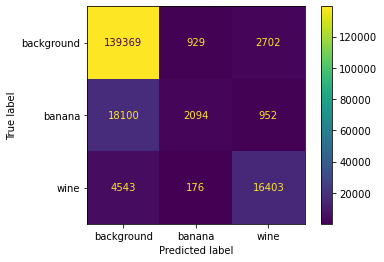

In [152]:
metric_report(ytest, y_pred, plot_conf_mtx=True, clf=clf_boost, X=xtest)

After analyzing confusion matrixx, we can see that the model has good performance on background (as always) and wine class. SMOTE could have improved performance on wine class, but banana examples are still hard to detect.

In [138]:
set(df_test['id'])

{1, 10, 13, 15, 21, 29, 30, 32, 33, 41, 46, 55, 59, 60, 69, 75, 76, 83, 92, 94}

In [140]:
probs_mtx = clf_boost.predict_proba(xtest)

As we can see in the next cells, wine stimulus is clearly detected but in the moments when stimulus begins/ends, however a instantaneous prediction is not necessary in most cases.

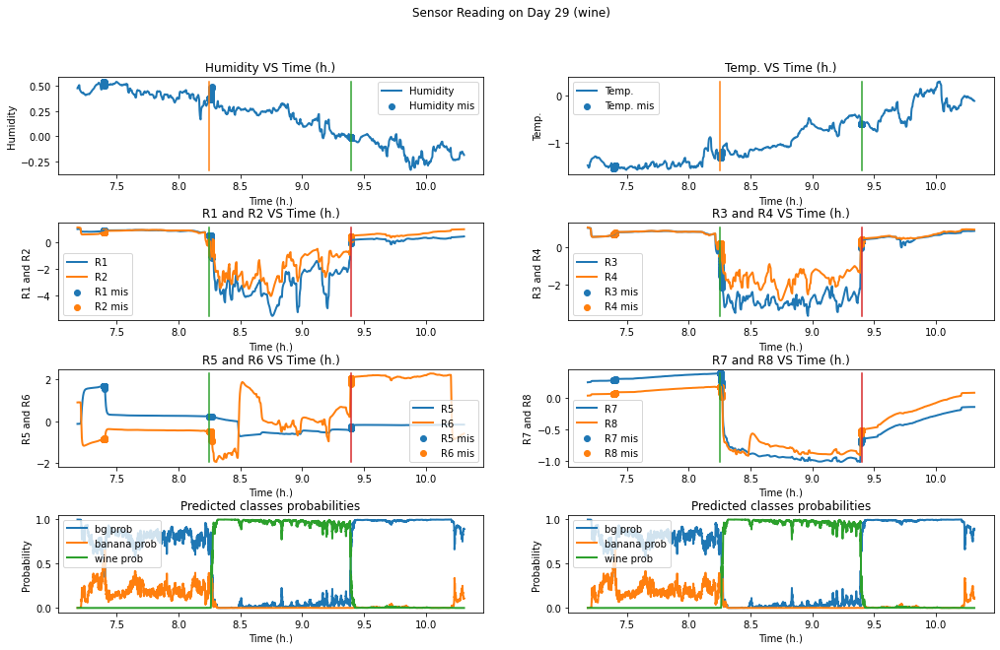

In [146]:
plot_misclassified_byID(df_test, 29, ytest, y_pred, probs_mtx=probs_mtx)

On the other hand, banana examples are still hard to classify correctly. Despite of the bad performance, we can check (in the probabilities graphics) that the probability of banana has increased considerably, a model that would take into account last measures probabilities could improve banana performace detecting increases in the banana probability. 

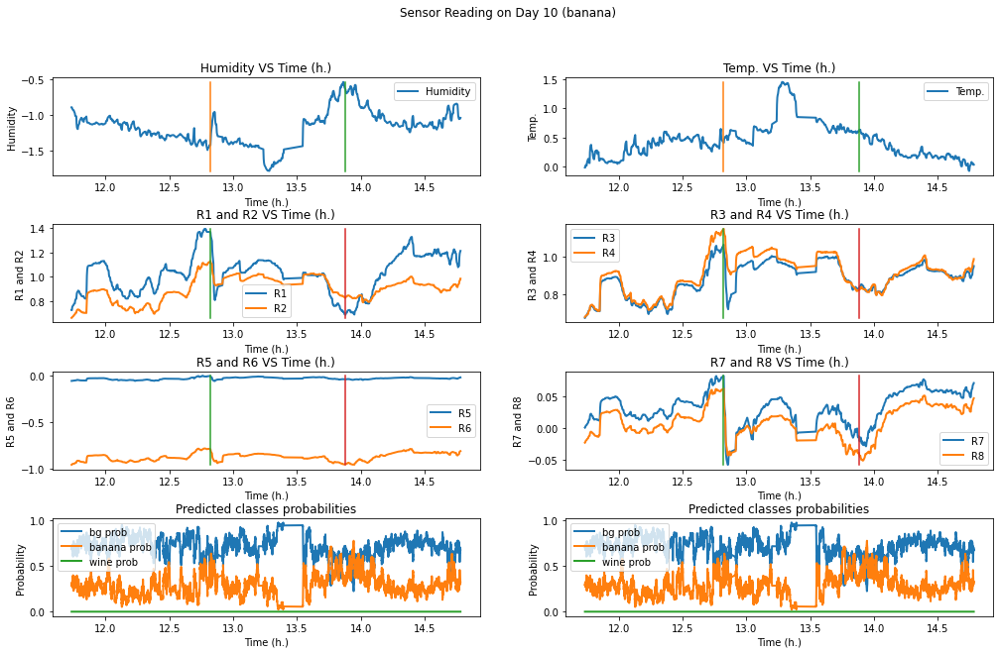

In [156]:
plot_probs_byID(df_test, 10, probs_mtx)

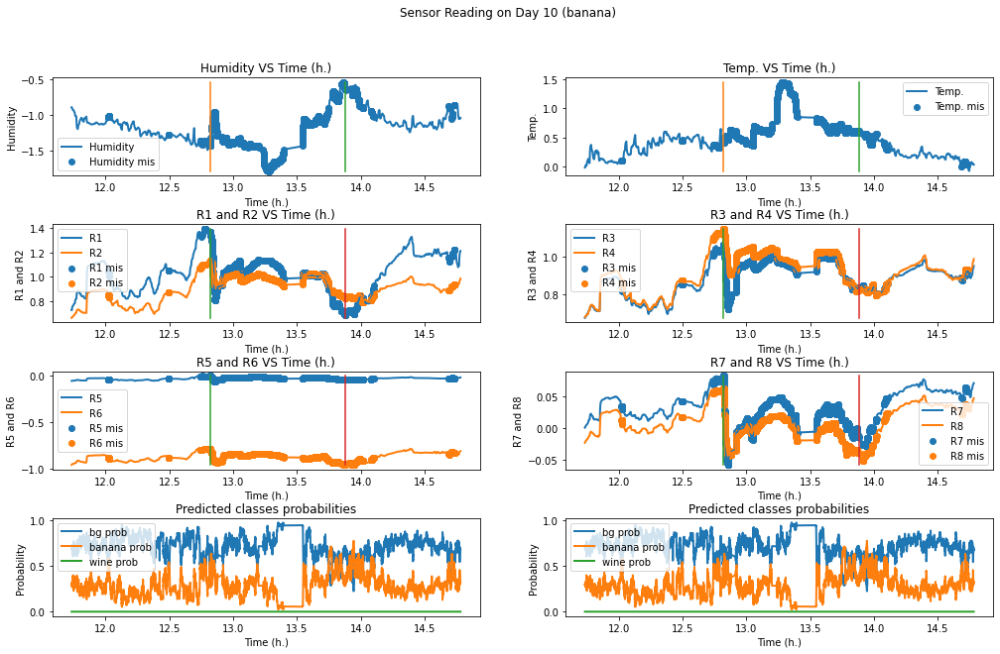

In [155]:
plot_misclassified_byID(df_test, 10, ytest, y_pred, probs_mtx=probs_mtx)